# Project Feature Selection, Model Selection and Tuning
# Andres Delgadillo

## 1 Project: Credit Card Users Churn Prediction

### 1.1 Objective

- Explore and visualize the dataset.
- Build a classification model to predict if the customer is going to churn or not
- Optimize the model using appropriate techniques
- Generate a set of insights and recommendations that will help the bank 

### 1.2 Data Dictionary

- `CLIENTNUM`: Client number. Unique identifier for the customer holding the account
- `Attrition_Flag`: Internal event (customer activity) variable - if the account is closed then "Attrited Customer" else "Existing Customer"
- `Customer_Age`: Age in Years
- `Gender`: Gender of the account holder
- `Dependent_count`: Number of dependents
- `Education_Level`:  Educational Qualification of the account holder - Graduate, High School, Unknown, Uneducated, College(refers to a college student), Post-Graduate, Doctorate.
- `Marital_Status`: Marital Status of the account holder
- `Income_Category`: Annual Income Category of the account holder
- `Card_Category`: Type of Card
- `Months_on_book`: Period of relationship with the bank
- `Total_Relationship_Count`: Total no. of products held by the customer
- `Months_Inactive_12_mon`: No. of months inactive in the last 12 months
- `Contacts_Count_12_mon`: No. of Contacts between the customer and bank in the last 12 months
- `Credit_Limit`: Credit Limit on the Credit Card
- `Total_Revolving_Bal`: The balance that carries over from one month to the next is the revolving balance
- `Avg_Open_To_Buy`: Open to Buy refers to the amount left on the credit card to use (Average of last 12 months)
- `Total_Trans_Amt`: Total Transaction Amount (Last 12 months)
- `Total_Trans_Ct`: Total Transaction Count (Last 12 months)
- `Total_Ct_Chng_Q4_Q1`: Ratio of the total transaction count in 4th quarter and the total transaction count in 1st quarter
- `Total_Amt_Chng_Q4_Q1`: Ratio of the total transaction amount in 4th quarter and the total transaction amount in 1st quarter
- `Avg_Utilization_Ratio`: Represents how much of the available credit the customer spent

### 1.3 Questions to be answered
- Why a customer decides to close the Credit Card?
- What are the main characteristics of those customers?
- How the bank could improve the business to avoid customers closing their accounts?


## 2 Import packages and turnoff warnings

In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import pandas_profiling
sns.set(color_codes=True)
%matplotlib inline

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import f1_score,accuracy_score, recall_score, precision_score, roc_auc_score, roc_curve, confusion_matrix, precision_recall_curve
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier, BaggingClassifier, RandomForestClassifier, StackingClassifier
from xgboost import XGBClassifier

from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import make_pipeline

## 3 Import dataset and quality of data

In [2]:
# read data from csv file
data = pd.read_csv('BankChurners.csv')

In [3]:
# get columns
data.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')

In [4]:
# get size of dataset
data.shape

(10127, 21)

In [5]:
# check dataset information 
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           8608 non-null   object 
 6   Marital_Status            9378 non-null   object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

In [6]:
# check dataset missing values
total = data.isnull().sum().sort_values(ascending=False) # total number of null values
print(total)

Education_Level             1519
Marital_Status               749
CLIENTNUM                      0
Contacts_Count_12_mon          0
Total_Ct_Chng_Q4_Q1            0
Total_Trans_Ct                 0
Total_Trans_Amt                0
Total_Amt_Chng_Q4_Q1           0
Avg_Open_To_Buy                0
Total_Revolving_Bal            0
Credit_Limit                   0
Total_Relationship_Count       0
Months_Inactive_12_mon         0
Attrition_Flag                 0
Months_on_book                 0
Card_Category                  0
Income_Category                0
Dependent_count                0
Gender                         0
Customer_Age                   0
Avg_Utilization_Ratio          0
dtype: int64


In [7]:
# check for duplicates
data.duplicated().sum()

0

This first assessment of the dataset shows:
- There are 10127 rows and 21 features
- Education_Level and Marital_Status have missing data
- There are not duplicated rows

## 4 Exploratory Data Analysis

In [8]:
# check first rows of data
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,NaN,Less than $40K,Blue,34,...,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [9]:
# check last rows of data
data.tail()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,...,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,710638233,Attrited Customer,41,M,2,NaN,Divorced,$40K - $60K,Blue,25,...,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,...,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,717406983,Attrited Customer,30,M,2,Graduate,NaN,$40K - $60K,Blue,36,...,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000
10126,714337233,Attrited Customer,43,F,2,Graduate,Married,Less than $40K,Silver,25,...,2,4,10388.0,1961,8427.0,0.703,10294,61,0.649,0.189


### 4.1 Pandas profiling report
We can get a first statistical and descriptive analysis using pandas_profiling

In [10]:
# get pandas profiling report
pandas_profiling.ProfileReport(data)

Pandas Profiling report is showing some warnings/characteristics in the data:
- Credit_Limit is highly correlated with Avg_Open_To_Buy
- Education_Level has 1519 (15.0%) missing values 
- Marital_Status has 749 (7.4%) missing values 
- CLIENTNUM is uniformly distributed, and all rows are unique values
- Income_Category has one category named `abc`
- Dependent_count, Contacts_Count_12_mon, Total_Revolving_Bal and Avg_Utilization_Ratio have several rows with zeros 
- Months_on_book have 36 as most frequent value in 24.3% of the rows


### 4.2 Univariate Analysis

In [11]:
# get stats for the columns
data.describe().T

,count,mean,std,min,25%,50%,75%,max
CLIENTNUM,10127.0,7.391776e+08,3.690378e+07,708082083.0,7.130368e+08,7.179264e+08,7.731435e+08,8.283431e+08
Customer_Age,10127.0,4.632596e+01,8.016814e+00,26.0,4.100000e+01,4.600000e+01,5.200000e+01,7.300000e+01
Dependent_count,10127.0,2.346203e+00,1.298908e+00,0.0,1.000000e+00,2.000000e+00,3.000000e+00,5.000000e+00
Months_on_book,10127.0,3.592841e+01,7.986416e+00,13.0,3.100000e+01,3.600000e+01,4.000000e+01,5.600000e+01
Total_Relationship_Count,10127.0,3.812580e+00,1.554408e+00,1.0,3.000000e+00,4.000000e+00,5.000000e+00,6.000000e+00
Months_Inactive_12_mon,10127.0,2.341167e+00,1.010622e+00,0.0,2.000000e+00,2.000000e+00,3.000000e+00,6.000000e+00
Contacts_Count_12_mon,10127.0,2.455317e+00,1.106225e+00,0.0,2.000000e+00,2.000000e+00,3.000000e+00,6.000000e+00
Credit_Limit,10127.0,8.631954e+03,9.088777e+03,1438.3,2.555000e+03,4.549000e+03,1.106750e+04,3.451600e+04
Total_Revolving_Bal,10127.0,1.162814e+03,8.149873e+02,0.0,3.590000e+02,1.276000e+03,1.784000e+03,2.517000e+03
Avg_Open_To_Buy,10127.0,7.469140e+03,9.090685e+03,3.0,1.324500e+03,3.474000e+03,9.859000e+03,3.451600e+04


- **Attrition_Flag**
    - There are 2 categories
    - 83.9% are Existing Customer, and 16.1% are Attrited Customer
- **Customer_Age**
    - Age is between 26 and 73
    - Median is 46 and mean is 46.3
    - There are not outliers
- **Gender**
    - There are 2 categories
    - 52.9% are Female (F), and 47.1% are Male (M)
- **Dependent_count**
    - Number of dependents is between 0 and 5
    - Median is 2 and mean is 2.34
    - There are not outliers
- **Education_Level**
    - There are 6 categories
    - Graduate (30.9%), High School (19.9%), Uneducated (14.7%), College (10.0%), Post-Graduate	(5.1%) and Doctorate (4.5%)
    - There are 15.0% of rows with missing values
- **Marital_Status**
    - There are 3 categories
    - Married (46.3%), Single (38.9%) and Divorced (7.4%)
    - There are 7.4% of rows with missing values
- **Income_Category**
    - There are 5 categories
    - Less than \\$40K (35.2%), \\$40K - \\$60K (17.7%), \\$60K - \\$80K (13.8%), \\$80K - \\$120K (15.2%) and \\$120K (7.2%)
    - There is another category abc (11.0%) with no clear meaning
- **Card_Category**
    - There are 4 categories
    - Blue (93.2%), Silver (5.5%), Gold (1.1%) and Platinum	(0.2%)
- **Months_on_book**
    - Months_on_book is between 13 and 56
    - Median is 36 and mean is 35.9
    - There are not outliers
- **Total_Relationship_Count**
    - Total_Relationship_Count is between 1 and 6
    - Median is 4 and mean is 3.8
    - There are not outliers
- **Months_Inactive_12_mon**
    - Months_Inactive_12_mon is between 0 and 6
    - Median is 2 and mean 2.3
    - There are not outliers
- **Contacts_Count_12_mon**
    - Contacts_Count_12_mon is between 0 and 6
    - Median is 2 and mean 2.4
    - There are not outliers
- **Credit_Limit**
    - Credit_Limit is 1438.3 and 34516
    - Median is 4549 and Mean is 8631.9
    - Distribution is skewed
- **Total_Revolving_Bal**
    - Total_Revolving_Bal is between 0 and 2517
    - Median is 1276 and mean 1162.8
- **Avg_Open_To_Buy**
    - Avg_Open_To_Buy is between 3 and 34516
    - Median is 3474 and mean 7469.1
    - Distribution is skewed
- **Total_Trans_Amt**
    - Total_Trans_Amt is between 510 and 18484
    - Median is 3899 and mean 4404.1
    - Distribution is skewed
- **Total_Trans_Ct**
    - Total_Trans_Ct is between 10 and 139
    - Median is 67 and mean 64.8
- **Total_Ct_Chng_Q4_Q1**
    - Total_Ct_Chng_Q4_Q1 is between 0 and 3.714
    - Median is 0.702 and mean 0.71
    - Distribution is skewed
- **Total_Amt_Chng_Q4_Q1**
    - Total_Amt_Chng_Q4_Q1 is between 0 and 3.397
    - Median 0.736 is and mean 0.759
    - Distribution is skewed
- **Avg_Utilization_Ratio**
    - Avg_Utilization_Ratio is between 0 and 0.999
    - Median is 0.176 and mean 0.275
    - Distribution is skewed

###  4.3 Pairplot.
We are going to perform bivariate analysis to understand the relationship between the columns

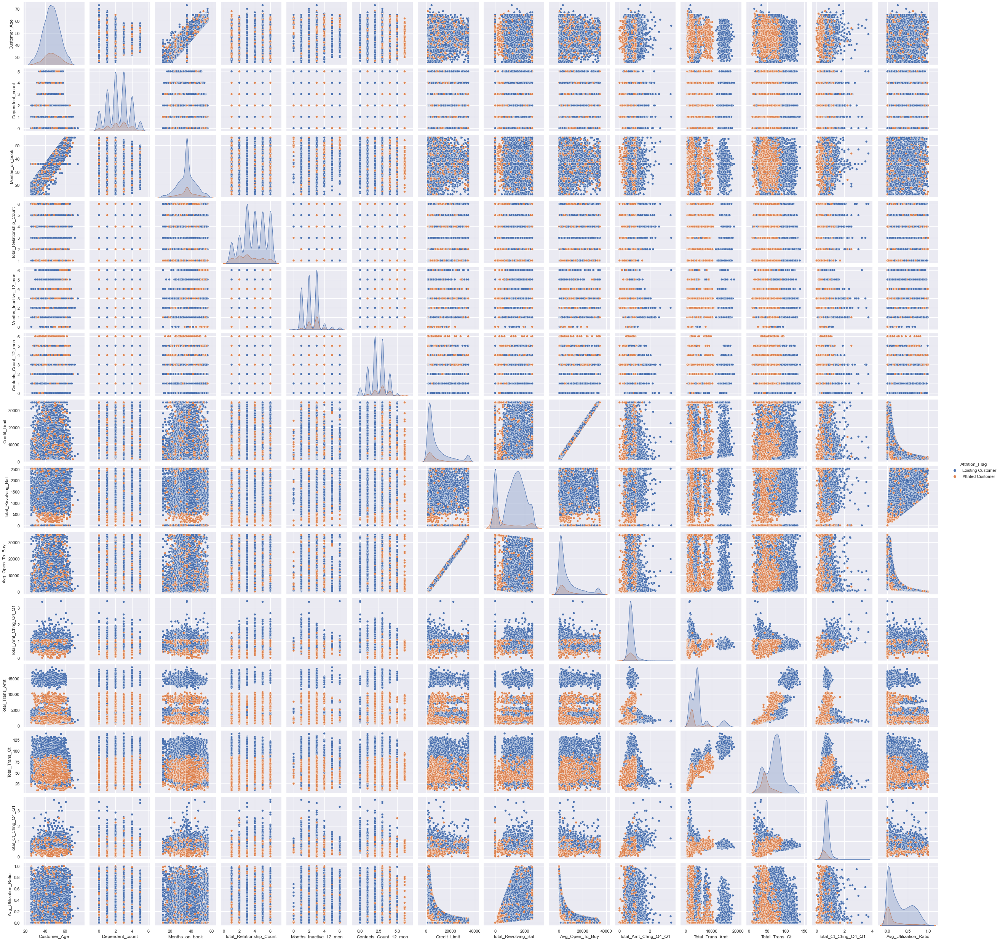

In [12]:
# Continuous columns + Attrition_Flag
con_col = ['Attrition_Flag', 'Customer_Age', 'Dependent_count', 
           'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
           'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
           'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
           'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']
# Pairplot for continuous columns
sns.pairplot(data[con_col], diag_kind='kde', hue='Attrition_Flag');

### 4.4 Bivariate and Multivariate Analysis

In [13]:
# Get correlation matrix for numeric variables
data[con_col].corr()

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
Customer_Age,1.000000,-0.122254,0.788912,-0.010931,0.054361,-0.018452,0.002476,0.014780,0.001151,-0.062042,-0.046446,-0.067097,-0.012143,0.007114
Dependent_count,-0.122254,1.000000,-0.103062,-0.039076,-0.010768,-0.040505,0.068065,-0.002688,0.068291,-0.035439,0.025046,0.049912,0.011087,-0.037135
Months_on_book,0.788912,-0.103062,1.000000,-0.009203,0.074164,-0.010774,0.007507,0.008623,0.006732,-0.048959,-0.038591,-0.049819,-0.014072,-0.007541
Total_Relationship_Count,-0.010931,-0.039076,-0.009203,1.000000,-0.003675,0.055203,-0.071386,0.013726,-0.072601,0.050119,-0.347229,-0.241891,0.040831,0.067663
Months_Inactive_12_mon,0.054361,-0.010768,0.074164,-0.003675,1.000000,0.029493,-0.020394,-0.042210,-0.016605,-0.032247,-0.036982,-0.042787,-0.038989,-0.007503
Contacts_Count_12_mon,-0.018452,-0.040505,-0.010774,0.055203,0.029493,1.000000,0.020817,-0.053913,0.025646,-0.024445,-0.112774,-0.152213,-0.094997,-0.055471
Credit_Limit,0.002476,0.068065,0.007507,-0.071386,-0.020394,0.020817,1.000000,0.042493,0.995981,0.012813,0.171730,0.075927,-0.002020,-0.482965
Total_Revolving_Bal,0.014780,-0.002688,0.008623,0.013726,-0.042210,-0.053913,0.042493,1.000000,-0.047167,0.058174,0.064370,0.056060,0.089861,0.624022
Avg_Open_To_Buy,0.001151,0.068291,0.006732,-0.072601,-0.016605,0.025646,0.995981,-0.047167,1.000000,0.007595,0.165923,0.070885,-0.010076,-0.538808
Total_Amt_Chng_Q4_Q1,-0.062042,-0.035439,-0.048959,0.050119,-0.032247,-0.024445,0.012813,0.058174,0.007595,1.000000,0.039678,0.005469,0.384189,0.035235


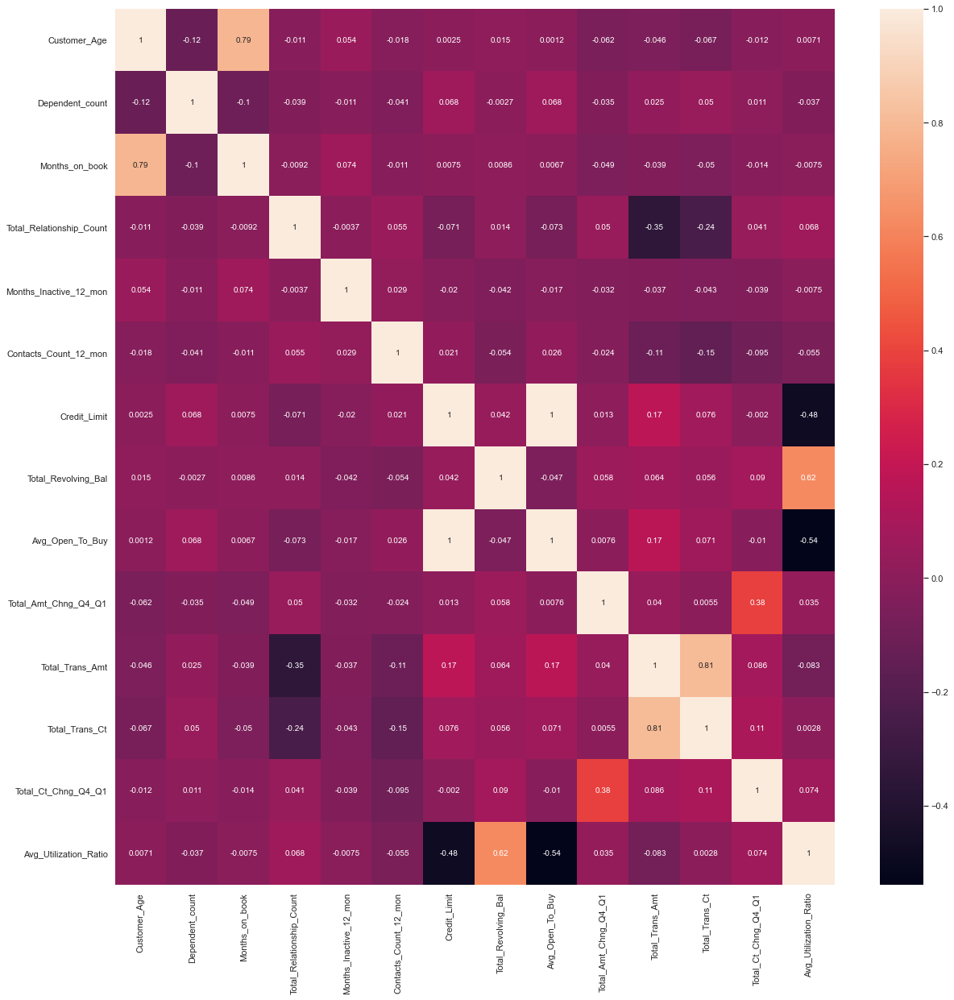

In [14]:
# Display correlation matrix in a heatmap
fig, ax = plt.subplots(figsize=(20,20)) 
sns.heatmap(data[con_col].corr(), annot=True, ax=ax);

There are several features with strong positive correlation:
- Credit_Limit and Avg_Open_To_Buy have 0.99 correlation
- Total_Trans_Amt and Total_Trans_Ct have 0.81 correlation
- Customer_Age and Months_on_book have 0.79 correlation
- Avg_Utilization_Ratio and Total_Revolving_Bal have 0.62 correlation

There are some features with negative correlation
- Credit_Limit and Avg_Utilization_Ratio
- Avg_Open_To_Buy and Avg_Utilization_Ratio
- Total_Trans_Amt and Total_Relationship_Count

#### 4.4.1 Months_on_book and Customer_Age

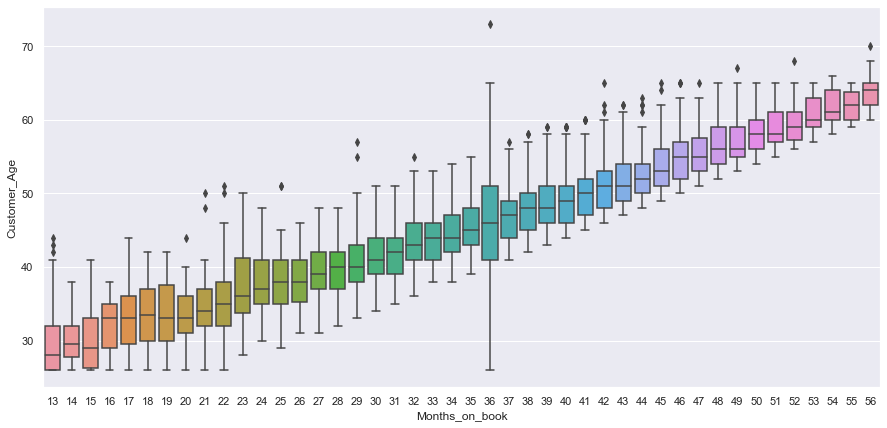

In [15]:
# Create boxplot for Months_on_book and Customer_Age
fig, ax = plt.subplots(figsize=(15,7)) 
sns.boxplot(data['Months_on_book'],data['Customer_Age']);

- There is positive correlation between Months_on_book and Customer_Age
- For 36 Months_on_book, the range of Customer_Age is the biggest and goes from 27 to 73
- The frequency of 36 Months is higher than for the rest of the months on book. There could be several reasons that explain this behavior like campaigns carried out by the bank in which many numbers of customers opened accounts in that specific time

#### 4.4.2 Gender and Attrition_Flag

In [16]:
### Function to plot stacked bar charts for categorical columns
def stacked_plot(x,hue):
    tab = 100*pd.crosstab(x,hue,normalize='index').sort_values(by=hue[0])
    print(tab.T)
    tab.plot(kind='bar',stacked=True)

Gender                     F          M
Attrition_Flag                         
Attrited Customer  17.357223  14.615223
Existing Customer  82.642777  85.384777


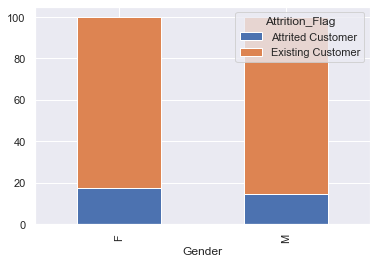

In [17]:
# Plot the stacked plot
stacked_plot(data['Gender'], data['Attrition_Flag'])

- The percentage of Attrited and Existing Customers is similar for both Female and Male groups

#### 4.4.3 Education_Level and Attrition_Flag

Education_Level    Doctorate  Post-Graduate  Uneducated   Graduate    College  \
Attrition_Flag                                                                  
Attrited Customer  21.064302      17.829457    15.93813  15.569054  15.202369   
Existing Customer  78.935698      82.170543    84.06187  84.430946  84.797631   

Education_Level    High School  
Attrition_Flag                  
Attrited Customer    15.201192  
Existing Customer    84.798808  


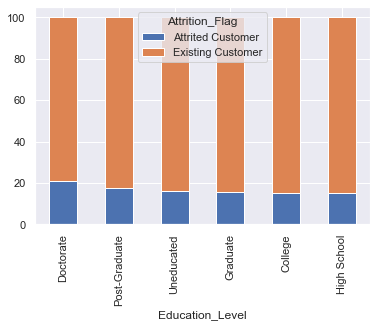

In [18]:
# Plot the stacked plot
stacked_plot(data['Education_Level'], data['Attrition_Flag'])

- The percentage of Attrited and Existing Customers is similar for the different Education categories. However, the percentage of Attrited customers is higher for Doctorate and Post-Graduated customers

#### 4.4.4 Marital_Status and Attrition_Flag

Marital_Status        Single   Divorced    Married
Attrition_Flag                                    
Attrited Customer  16.941415  16.176471  15.126947
Existing Customer  83.058585  83.823529  84.873053


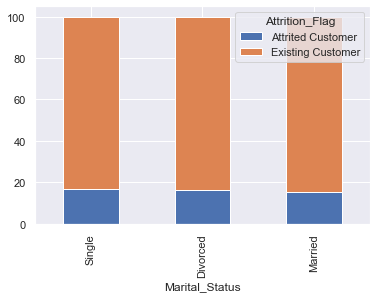

In [19]:
# Plot the stacked plot
stacked_plot(data['Marital_Status'], data['Attrition_Flag'])

- The percentage of Attrited and Existing Customers is similar for the different Marital Status categories

#### 4.4.5 Income_Categoryx and Attrition_Flag

Income_Category      $120K +  Less than $40K        abc  $80K - $120K  \
Attrition_Flag                                                          
Attrited Customer  17.331499       17.186184  16.816547     15.765472   
Existing Customer  82.668501       82.813816  83.183453     84.234528   

Income_Category    $40K - $60K  $60K - $80K  
Attrition_Flag                               
Attrited Customer    15.139665    13.480742  
Existing Customer    84.860335    86.519258  


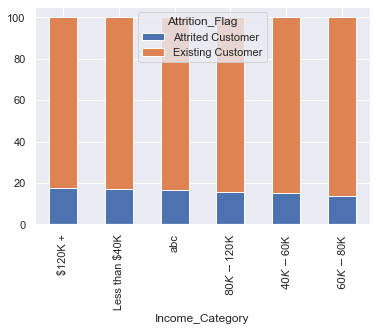

In [20]:
# Plot the stacked plot
stacked_plot(data['Income_Category'], data['Attrition_Flag'])

- The percentage of Attrited and Existing Customers is similar for the different Income categories. 
- `\\$120K +` and `Less than \\$40K` categories have the highest proportion of Attrited Customers.

#### 4.4.6 Card_Category and Attrition_Flag

Card_Category      Platinum       Gold       Blue     Silver
Attrition_Flag                                              
Attrited Customer      25.0  18.103448  16.097923  14.774775
Existing Customer      75.0  81.896552  83.902077  85.225225


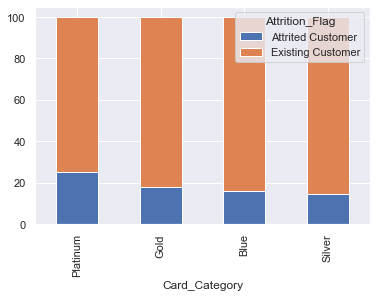

In [21]:
# Plot the stacked plot
stacked_plot(data['Card_Category'], data['Attrition_Flag'])

- The percentage of Attrited Customers is the highest in Platinum Cards (25% of the Platinum cards)
- The percentage of Attrited Customers is the lowest in Silver Cards (15% of the Silver cards)

#### 4.4.7 Attrition_Flag and Continuous features

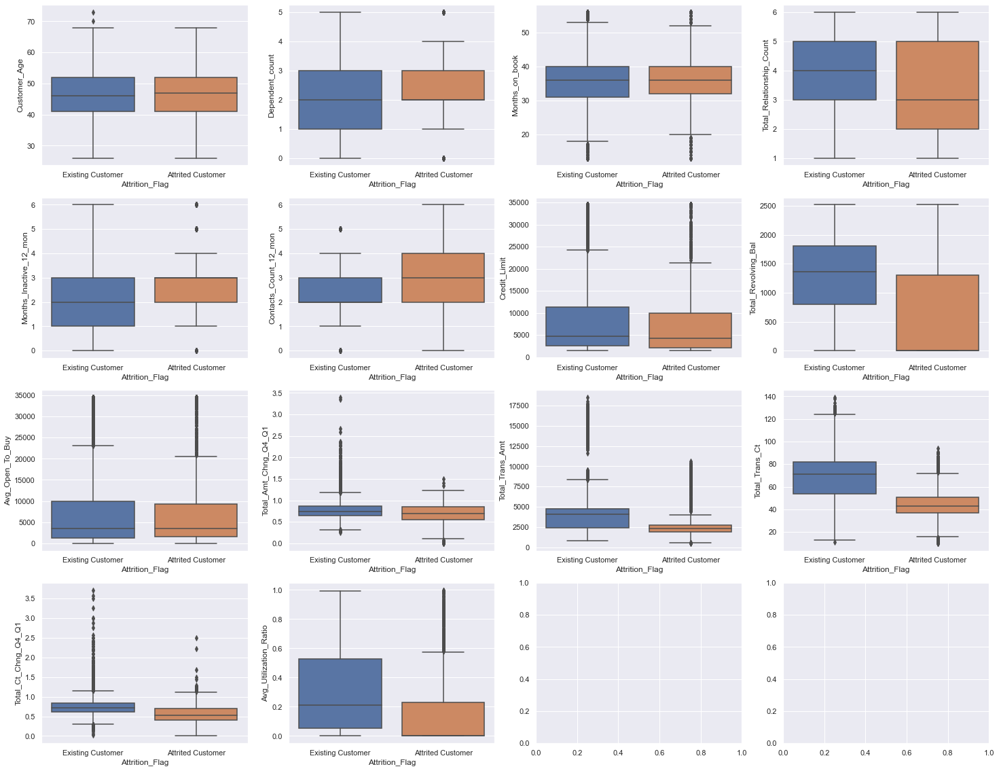

In [22]:
# Create subplots for the different boxplot charts
fig, axes = plt.subplots(4, 4, figsize=(25, 20))
i=1
# loop in rows and columns of the subplot
for row in range(4):
    for col in range(4):
        if i<len(con_col):
            # select the specific feature in con_col
            feature = con_col[i]
            # dsiplay the boxplot
            sns.boxplot(data['Attrition_Flag'], data[feature], ax=axes[row, col], )
        i += 1

**Observations**
- Customer_Age have similar range for both Existing and Attritied Customers. Although, the median is higher for Attritied Customers
- The normal range of Dependent_Count is higher for Existing Customers
- Months_on_book have a similar pattern for both Existing and Attritied Customers
- The median of Total_Relationship_Count is lower for Attritied Customers
- The median of Months_Inactive_12_mon is higher for  Attritied Customers
- The range and the median of Contacts_Count_12_mon is higher for Attritied Customers
- Credit_Limit have a similar pattern for both Existing and Attritied Customers
- Total_Revolving_Bal is lower for Attritied Customers
- Avg_Open_To_Buy have a similar pattern for both Existing and Attritied Customers
- The range and median values for Total_Amt_Chng_Q4_Q1, Total_Trans_Amt, Total_Trans_Ct, Total_Ct_Chng_Q4_Q1, and Avg_Utilization_Ratio are lower for Attritied Customers

## 5 Data Pre-Processing

### 5.1 Feature Engineering
- Drop CLIENTNUM column
- Drop Avg_Open_To_Buy due to the high correlation with Credit_Limit
- Correct `abc` category in Income_Category. We will treat `abc` as missing value

In [23]:
# Drop CustomerID column
data.drop(['CLIENTNUM'], axis=1, inplace=True)
# Drop Designation column
data.drop(['Avg_Open_To_Buy'], axis=1, inplace=True)

In [24]:
# Asign abc as NaN in Income_Category
data['Income_Category'][data['Income_Category']=='abc'] = np.nan

In [25]:
# Check data info
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  object 
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  object 
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           8608 non-null   object 
 5   Marital_Status            9378 non-null   object 
 6   Income_Category           9015 non-null   object 
 7   Card_Category             10127 non-null  object 
 8   Months_on_book            10127 non-null  int64  
 9   Total_Relationship_Count  10127 non-null  int64  
 10  Months_Inactive_12_mon    10127 non-null  int64  
 11  Contacts_Count_12_mon     10127 non-null  int64  
 12  Credit_Limit              10127 non-null  float64
 13  Total_Revolving_Bal       10127 non-null  int64  
 14  Total_

### 5.2 Outliers detection
We are going to analyze if there are outliers in the continuous features

In [26]:
# This function create a plot with the boxplot and distribution of the series
def histboxplot(feature):
    # creating the 2 subplots
    f2, (ax_box1, ax_hist1) = plt.subplots(nrows = 2, # Number of rows of the subplot grid= 2
                                           ncols = 1, # Number of Columns of the subplot grid= 1
                                           sharex = 'col', # x-axis will be shared among columns
                                           figsize = (7,6),
                                           gridspec_kw = {"height_ratios": (.25, .75)});
    sns.boxplot(feature, ax=ax_box1, showmeans=True, color='violet'); # boxplot 
    sns.distplot(feature, kde=True, ax=ax_hist1); # histogram
    ax_hist1.axvline(np.mean(feature), color='green', linestyle='--'); # Add mean to the histogram
    ax_hist1.axvline(np.median(feature), color='black', linestyle='-');

**Customer_Age**

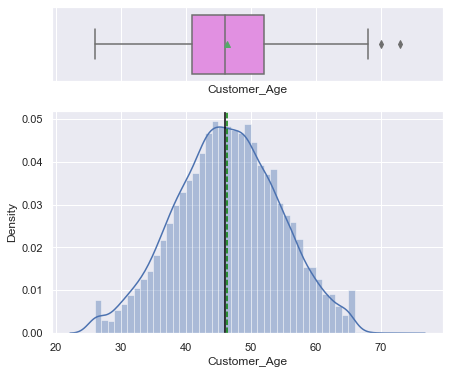

In [27]:
# display histbox 
histboxplot(data['Customer_Age'])

- There are some extreme values above 70 years old but those are normal and expected values

**Dependent_count**

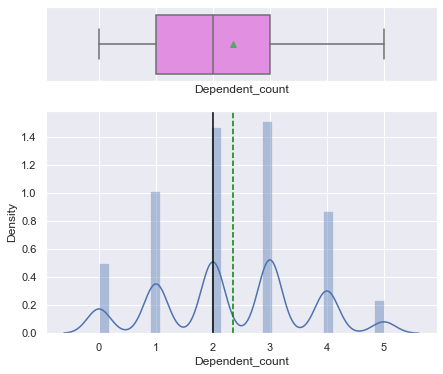

In [28]:
# display histbox 
histboxplot(data['Dependent_count'])

- There are not outliers

**Months_on_book**

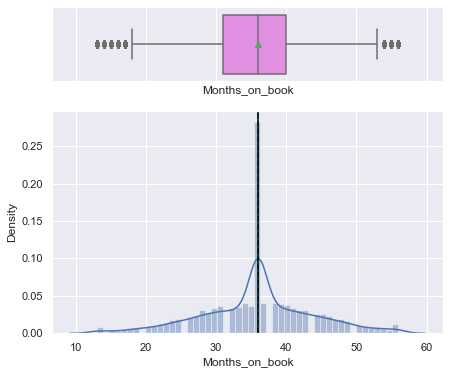

In [29]:
# display histbox 
histboxplot(data['Months_on_book'])

- There are some extreme values outside the whiskers but those are expected values

**Total_Relationship_Count**

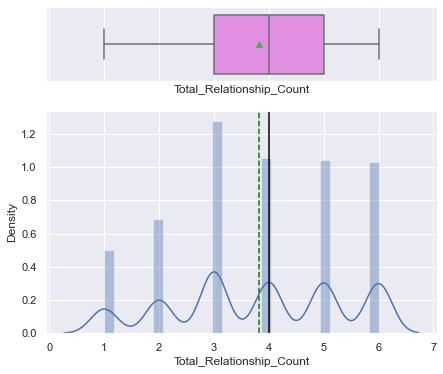

In [30]:
# display histbox 
histboxplot(data['Total_Relationship_Count'])

- There are not outliers

**Months_Inactive_12_mon**

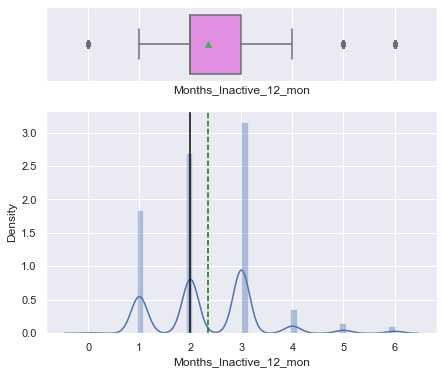

In [31]:
# display histbox 
histboxplot(data['Months_Inactive_12_mon'])

- There are not outliers

**Contacts_Count_12_mon**

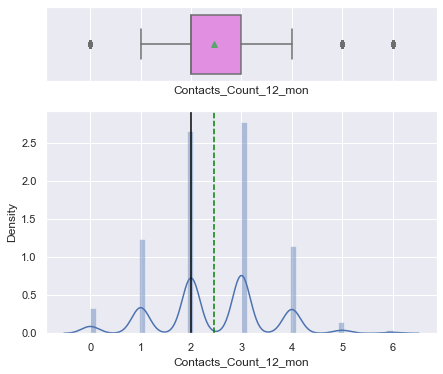

In [32]:
# display histbox 
histboxplot(data['Contacts_Count_12_mon'])

- There are not outliers

**Credit_Limit**

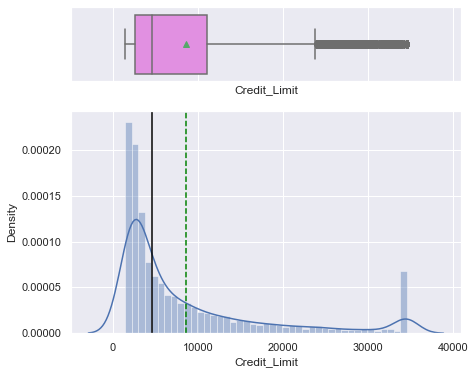

In [33]:
# display histbox 
histboxplot(data['Credit_Limit'])

- There are some extreme values above the upper whisker. However, those values could represent customers with special characteristics and we are not going to modify these values 

**Total_Revolving_Bal**

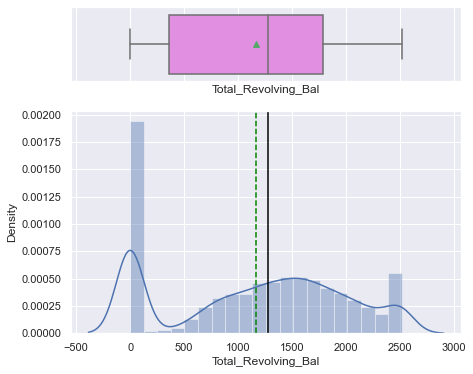

In [34]:
# display histbox 
histboxplot(data['Total_Revolving_Bal'])

- There are not outliers

**Total_Amt_Chng_Q4_Q1**

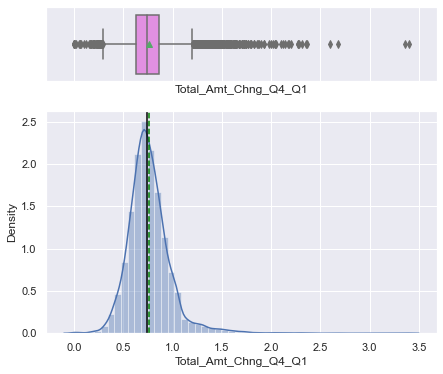

In [35]:
# display histbox 
histboxplot(data['Total_Amt_Chng_Q4_Q1'])

- There are some extreme values outside the whiskers. We are going to clip values above 2.5

In [36]:
# clip values
data['Total_Amt_Chng_Q4_Q1']=np.clip(data['Total_Amt_Chng_Q4_Q1'], 0, 2.5)

**Total_Trans_Amt**

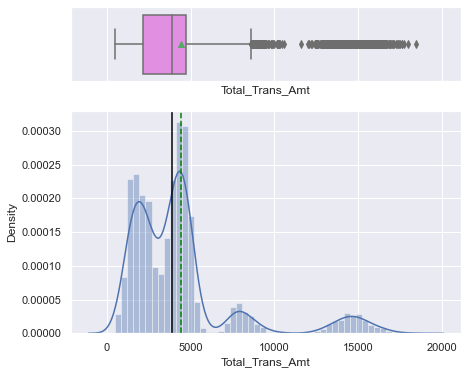

In [37]:
# display histbox 
histboxplot(data['Total_Trans_Amt'])

- There are some extreme values above the upper whisker. However, they are under the expected zone and we are not going to cap them.

**Total_Trans_Ct**

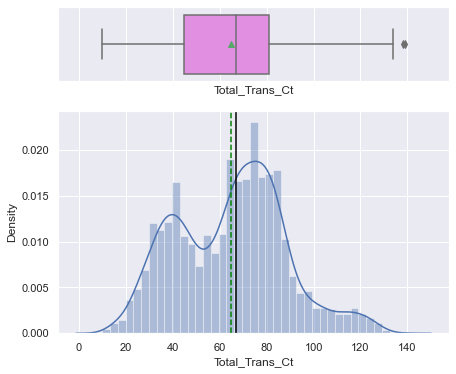

In [38]:
# display histbox 
histboxplot(data['Total_Trans_Ct'])

- There are not outliers

**Total_Ct_Chng_Q4_Q1**

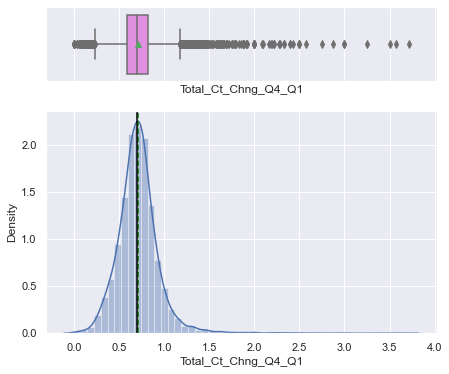

In [39]:
# display histbox 
histboxplot(data['Total_Ct_Chng_Q4_Q1'])

- There are some extreme values above the upper whisker. We are going to clip the values above 2.5

In [40]:
# clip values
data['Total_Ct_Chng_Q4_Q1']=np.clip(data['Total_Ct_Chng_Q4_Q1'], 0, 2.5)

**Avg_Utilization_Ratio**

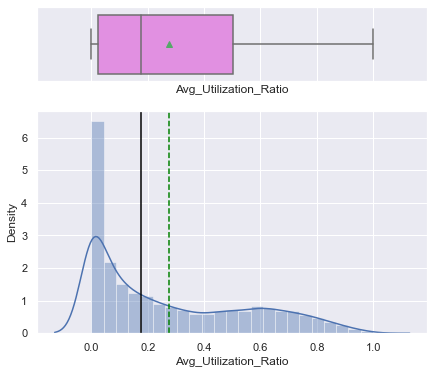

In [41]:
# display histbox 
histboxplot(data['Avg_Utilization_Ratio'])

- There are not outliers

### 5.3 Missing-Value treatment
- Education_Level has 1519 (15.0%) missing values 
- Marital_Status has 749 (7.4%) missing values 
- Income_Category has 1112 (11.0%) missing values

**Treatment**
* We will use KNN imputer to impute missing values
* Education_Level, Marital_Status, and Income_Category are categorical features. To take care of that we will round off the obtained values to nearest integer value

In [42]:
data.isnull().sum()

Attrition_Flag                 0
Customer_Age                   0
Gender                         0
Dependent_count                0
Education_Level             1519
Marital_Status               749
Income_Category             1112
Card_Category                  0
Months_on_book                 0
Total_Relationship_Count       0
Months_Inactive_12_mon         0
Contacts_Count_12_mon          0
Credit_Limit                   0
Total_Revolving_Bal            0
Total_Amt_Chng_Q4_Q1           0
Total_Trans_Amt                0
Total_Trans_Ct                 0
Total_Ct_Chng_Q4_Q1            0
Avg_Utilization_Ratio          0
dtype: int64

In [43]:
# defining a list with names of columns that will be used for imputation
reqd_col_for_impute = ['Customer_Age', 'Gender', 'Dependent_count',
       'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt', 'Total_Trans_Ct',
       'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']
# create a copy of the dataset for encoding 
data1 = data.copy()

In [44]:
# Encoding categorical values
Gender = {'M': 0, 'F': 1}
data1['Gender'] = data1['Gender'].map(Gender)

Education_Level = {'Graduate': 0,
                   'High School': 1, 
                   'Uneducated': 2, 
                   'College': 3,
                   'Post-Graduate': 4,
                   'Doctorate': 5}
data1['Education_Level'] = data1['Education_Level'].map(Education_Level)

Marital_Status = {'Married': 0, 'Single': 1, 'Divorced': 2}
data1['Marital_Status'] = data1['Marital_Status'].map(Marital_Status)

Income_Category = {'$60K - $80K': 0,
                   'Less than $40K': 1, 
                   '$80K - $120K': 2,
                   '$40K - $60K': 3,
                   '$120K +': 4}
data1['Income_Category'] = data1['Income_Category'].map(Income_Category)

Card_Category = {'Blue': 0, 'Gold': 1, 'Silver': 2, 'Platinum': 3}
data1['Card_Category'] = data1['Card_Category'].map(Card_Category)

In [45]:
# check that all variables are numeric
data1[reqd_col_for_impute].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 18 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Customer_Age              10127 non-null  int64  
 1   Gender                    10127 non-null  int64  
 2   Dependent_count           10127 non-null  int64  
 3   Education_Level           8608 non-null   float64
 4   Marital_Status            9378 non-null   float64
 5   Income_Category           9015 non-null   float64
 6   Card_Category             10127 non-null  int64  
 7   Months_on_book            10127 non-null  int64  
 8   Total_Relationship_Count  10127 non-null  int64  
 9   Months_Inactive_12_mon    10127 non-null  int64  
 10  Contacts_Count_12_mon     10127 non-null  int64  
 11  Credit_Limit              10127 non-null  float64
 12  Total_Revolving_Bal       10127 non-null  int64  
 13  Total_Amt_Chng_Q4_Q1      10127 non-null  float64
 14  Total_

### 5.4 Data Preparation for Modeling
#### 5.4.1 Training, validation and test sets
We are going to define Attrited Customers with 1 and Existing Customers with 0

In [46]:
# create independent variables
X = data1.drop(['Attrition_Flag'], axis=1)
# create dependent variable
y = data1['Attrition_Flag'].apply(lambda x: 1 if x == 'Attrited Customer' else 0)

In [47]:
# Splitting data into training, validation and test set:
# first we split data into 2 parts, say temporary and test
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.2, random_state=1, stratify=y)

# then we split the temporary set into train and validation
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.25, random_state=1, stratify=y_temp)

print(f'Shape of Training set: {X_train.shape}')
print(f'Shape of Validation set: {X_val.shape}')
print(f'Shape of Test set: {X_test.shape}')
print(f'Percentage of classes in Training set\n{y_train.value_counts(normalize=True)}')
print(f'Percentage of classes in Validation set\n{y_val.value_counts(normalize=True)}')
print(f'Percentage of classes in Test set\n{y_test.value_counts(normalize=True)}')

Shape of Training set: (6075, 18)
Shape of Validation set: (2026, 18)
Shape of Test set: (2026, 18)
Percentage of classes in Training set
0    0.839342
1    0.160658
Name: Attrition_Flag, dtype: float64
Percentage of classes in Validation set
0    0.839092
1    0.160908
Name: Attrition_Flag, dtype: float64
Percentage of classes in Test set
0    0.839585
1    0.160415
Name: Attrition_Flag, dtype: float64


- Training, validation and test set have similar ratios of classes for Attrition_Flag

#### 5.4.2 Imputing Missing Values

In [48]:
# We will use KNN imputer to impute missing values
imputer = KNNImputer(n_neighbors=5)

In [49]:
# Fit and transform the train data
X_train[reqd_col_for_impute] = imputer.fit_transform(X_train[reqd_col_for_impute])

# Transform the validation data
X_val[reqd_col_for_impute] = imputer.fit_transform(X_val[reqd_col_for_impute])

# Transform the test data
X_test[reqd_col_for_impute] = imputer.transform(X_test[reqd_col_for_impute])

In [50]:
# Checking that no column has missing values in train, validation or test sets
print(X_train.isna().sum())
print("-" * 30)
print(X_val.isna().sum())
print("-" * 30)
print(X_test.isna().sum())

Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
dtype: int64
------------------------------
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Total_Amt_Chng_Q4_Q1      

- All missing values have been treated

**Inverse map the encoded values**

In [51]:
## Function to inverse the encoding
def inverse_mapping(x, y):
    inv_dict = {v: k for k, v in x.items()}
    X_train[y] = np.round(X_train[y]).map(inv_dict).astype("category")
    X_val[y] = np.round(X_val[y]).map(inv_dict).astype("category")
    X_test[y] = np.round(X_test[y]).map(inv_dict).astype("category")

In [52]:
# inverse mapping encoded values
inverse_mapping(Gender, "Gender")
inverse_mapping(Education_Level, "Education_Level")
inverse_mapping(Marital_Status, "Marital_Status")
inverse_mapping(Income_Category, "Income_Category")
inverse_mapping(Card_Category, "Card_Category")

In [53]:
# Checking inverse mapped values/categories in train set
cols = X_train.select_dtypes(include=["object", "category"])
for i in cols.columns:
    print(X_train[i].value_counts())
    print("-" * 30)

F    3193
M    2882
Name: Gender, dtype: int64
------------------------------
Graduate         1918
High School      1689
Uneducated       1239
College           662
Post-Graduate     313
Doctorate         254
Name: Education_Level, dtype: int64
------------------------------
Married     3006
Single      2639
Divorced     430
Name: Marital_Status, dtype: int64
------------------------------
Less than $40K    2409
$80K - $120K      1260
$40K - $60K       1113
$60K - $80K        838
$120K +            455
Name: Income_Category, dtype: int64
------------------------------
Blue        5655
Silver       339
Gold          69
Platinum      12
Name: Card_Category, dtype: int64
------------------------------


In [54]:
# Checking inverse mapped values/categories in validation set
cols = X_val.select_dtypes(include=["object", "category"])
for i in cols.columns:
    print(X_val[i].value_counts())
    print("-" * 30)

F    1095
M     931
Name: Gender, dtype: int64
------------------------------
Graduate         643
High School      540
Uneducated       419
College          221
Post-Graduate    104
Doctorate         99
Name: Education_Level, dtype: int64
------------------------------
Married     1021
Single       849
Divorced     156
Name: Marital_Status, dtype: int64
------------------------------
Less than $40K    827
$80K - $120K      403
$40K - $60K       377
$60K - $80K       282
$120K +           137
Name: Income_Category, dtype: int64
------------------------------
Blue        1905
Silver        97
Gold          21
Platinum       3
Name: Card_Category, dtype: int64
------------------------------


In [55]:
# Checking inverse mapped values/categories in test set
cols = X_test.select_dtypes(include=["object", "category"])
for i in cols.columns:
    print(X_test[i].value_counts())
    print("-" * 30)

F    1070
M     956
Name: Gender, dtype: int64
------------------------------
Graduate         673
High School      523
Uneducated       409
College          219
Post-Graduate    104
Doctorate         98
Name: Education_Level, dtype: int64
------------------------------
Married     974
Single      889
Divorced    163
Name: Marital_Status, dtype: int64
------------------------------
Less than $40K    792
$80K - $120K      407
$40K - $60K       391
$60K - $80K       293
$120K +           143
Name: Income_Category, dtype: int64
------------------------------
Blue        1876
Silver       119
Gold          26
Platinum       5
Name: Card_Category, dtype: int64
------------------------------


#### 5.4.3 Creating Dummy Variables

In [56]:
# hot encoding for categorical variables
X_train = pd.get_dummies(X_train, drop_first=True)
X_val = pd.get_dummies(X_val, drop_first=True)
X_test = pd.get_dummies(X_test, drop_first=True)
print(X_train.shape, X_val.shape, X_test.shape)

(6075, 28) (2026, 28) (2026, 28)


- After hot encoding there are 28 columns

## 6 Models evaluation criteria

### 6.1 Insights:

- **True Positives:**
    - Reality: The account is closed and the customer is an Attrited Customer
    - Model predicted: The customer is an Attrited Customer
    - Outcome: The bank can identify the characteristics of the customers that close their accounts
    
- **True Negatives:**
    - Reality: The account is open and the customer is an Existing Customer
    - Model predicted: The customer is an Existing Customer
    - Outcome: The model is good, and customer is keeping the credit card

- **False Positives:**
    - Reality: The account is open and the customer is an Existing Customer
    - Model predicted: The customer is an Attrited Customer
    - Outcome: The bank is not classifying correctly the customers that are closing their accounts
    
- **False Negatives:**
    - Reality: The account is closed and the customer is an Attrited Customer
    - Model predicted: The customer is an Existing Customer
    - Outcome: The bank is not classifying correctly the customers that are not closing their accounts

#### 6.1.1 Model can make wrong predictions as:
1. Predicting a customer closed the account but actually the customer keeps the credit card
2. Predicting a customer keeps the credit card but actually the customer closed the account

#### 6.1.2 Which case is more important? 
- Case 2 is more important because the bank needs to identify correctly the customers that are closing their accounts

#### 6.1.3 How to reduce this loss?
*  `Recall` should be used as a measured of the model performance. High recall score implies low False Negatives

### 6.2 Functions to evaluate models
- metrics_score: check the model performance of models. 
- make_confusion_matrix: plot confusion matrix.

In [57]:
# Function to calculate different metric scores of the classification model
def metrics_score(model,train,test,train_y,test_y,threshold=0.5,model_name=''):
    '''
    Inputs:
        model: classifier to predict values of X
        train, test: Independent features in train and test sets
        train_y,test_y: Dependent variable in train and test sets
        threshold: thresold for classifiying the observation as 1
        model_name: Name of the model
    '''
    
    # Make the prediction of the model in train and test sets
    pred_train = (model.predict_proba(train)[:,1]>threshold)
    pred_test = (model.predict_proba(test)[:,1]>threshold)

    # Calculate scores and save them in a dictionary
    score_dict = {'Model':model_name,
                  'Accuracy on training set' : accuracy_score(pred_train,train_y),
                  'Accuracy on validation set': accuracy_score(pred_test,test_y),
                  'Recall on training set': recall_score(train_y,pred_train),
                  'Recall on validation set': recall_score(test_y,pred_test),
                  'Precision on training set': precision_score(train_y,pred_train),
                  'Precision on validation set': precision_score(test_y,pred_test),
                  'F1 on training set': f1_score(train_y,pred_train),
                  'F1 on validation set': f1_score(test_y,pred_test)
                 }
    # Create a dataframe with scores
    scores = pd.DataFrame(score_dict,index=[0])
    # return the df
    return scores

In [58]:
# Function to display the confusion matrix 
def make_confusion_matrix(model,test_X,y_actual,threshold=0.5,labels=[1, 0]):
    '''
    Inputs:
        model : classifier to predict values of X
        test_X: test set
        y_actual : ground truth  
        threshold: thresold for classifiying the observation as 1
    '''
    # Make prediction of the model
    y_predict = (model.predict_proba(test_X)[:, 1] > threshold).astype('float')
    # calculate the confusion matrix
    cm = metrics.confusion_matrix( y_actual, y_predict, labels=[1,0])
    # create a dataframe to display the heatmap
    df_cm = pd.DataFrame(cm, 
                         index = ['Actual-Attritied Customer','Actual-Existing Customer'],
                         columns = ['Predicted-Attritied Customer','Predicted-Existing Customer'])
    # calculate the number of percentage of the confusion matrix for each category
    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.1%}".format(value) for value in cm.flatten()/np.sum(cm)]
    # create labels
    group_labels = ['(TP)', '(FN)', '(FP)', '(TN)']
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_counts,group_percentages,group_labels)]
    labels = np.asarray(labels).reshape(2,2)
    # display the confusion matrix in a heatmap
    plt.figure(figsize = (8,6))
    sns.heatmap(df_cm, annot=labels, fmt='')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

## 7 Model Building
### 7.1 Logistic Regression model

In [59]:
# create logistic regression model
lr = LogisticRegression(random_state=1)
lr.fit(X_train, y_train)

LogisticRegression(random_state=1)

**Model performance by using KFold and cross_val_score**

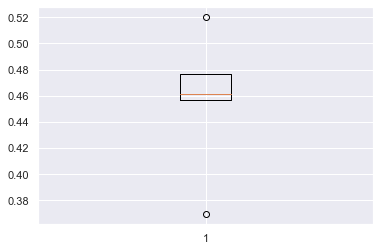

In [60]:
scoring = "recall"
# Setting number of splits equal to 5
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1) 
cv_result_bfr = cross_val_score(estimator=lr, X=X_train, y=y_train, scoring=scoring, cv=kfold)
# Plot boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

- Performance on training set varies between 0.38 to 0.52 recall.

**Performance on validation data**

In [61]:
# checking model performances for this model in train and validation sets
scores_lr = metrics_score(lr,X_train,X_val,y_train,y_val,model_name='Logistic Regression')
scores_lr

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Logistic Regression,0.876214,0.884995,0.472336,0.527607,0.660458,0.685259,0.550777,0.596187


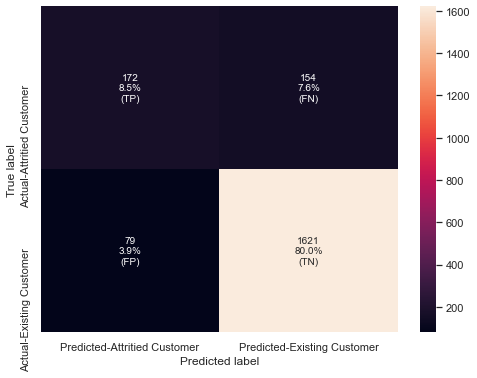

In [62]:
# creating confusion matrix
make_confusion_matrix(lr,X_val,y_val)

- Logistic Regression has given a generalized performance on training and validation sets.
- The model is not overfitting
- Recall on validation set is 0.53 and Precision is 0.68. 
- The model can be improved

### 7.2 Decision Tree model

* We will build our model using the DecisionTreeClassifier function, and using default 'gini' criteria to split
* The decision tree will give more weight to class 1 since our goal is to identify correctly Attritied Customers(class 1). We are going to pass a dictionary {0:0.16,1:0.84} to the hyperparameter class_weight to specify the weight of each class

In [63]:
# create decision tree model
dt = DecisionTreeClassifier(criterion="gini", class_weight={0: 0.16, 1: 0.84}, random_state=1)
dt.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.16, 1: 0.84}, random_state=1)

**Model performance by using KFold and cross_val_score**

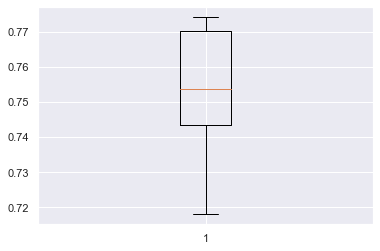

In [64]:
scoring = "recall"
# Setting number of splits equal to 5
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1) 
cv_result_bfr = cross_val_score(estimator=dt, X=X_train, y=y_train, scoring=scoring, cv=kfold)
# Plot boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

- Performance on training set varies between 0.72 to 0.77 recall.

**Performance on validation data**

In [65]:
# checking model performances for this model in train and validation sets
scores_dt = metrics_score(dt,X_train,X_val,y_train,y_val,model_name='Decision Tree')
scores_dt

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Decision Tree,1.0,0.941264,1.0,0.819018,1.0,0.816514,1.0,0.817764


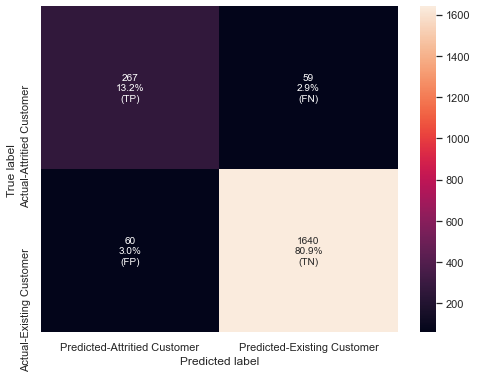

In [66]:
# creating confusion matrix
make_confusion_matrix(dt,X_val,y_val)

- Decision Tree is overfitting
- All metrics are 1 in the training set but lower in the validation set
- The model can be improved reducing the overfitting

### 7.3 Bagging Classifier model

In [67]:
# create bagging classifier with weighted decision tree
bc = BaggingClassifier(
                        base_estimator=DecisionTreeClassifier(criterion='gini',class_weight={0:0.16,1:0.84},random_state=1),
                        random_state=1)
bc.fit(X_train,y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(class_weight={0: 0.16,
                                                                      1: 0.84},
                                                        random_state=1),
                  random_state=1)

**Model performance by using KFold and cross_val_score**

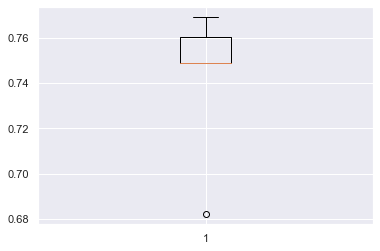

In [68]:
scoring = "recall"
# Setting number of splits equal to 5
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1) 
cv_result_bfr = cross_val_score(estimator=bc, X=X_train, y=y_train, scoring=scoring, cv=kfold)
# Plot boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

- Performance on training set varies between 0.68 to 0.76 recall.

**Performance on validation data**

In [69]:
# checking model performances for this model in train and validation sets
scores_bc = metrics_score(bc,X_train,X_val,y_train,y_val,model_name='Bagging Classifier')
scores_bc

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Bagging Classifier,0.996543,0.94077,0.979508,0.739264,0.998955,0.873188,0.989136,0.800664


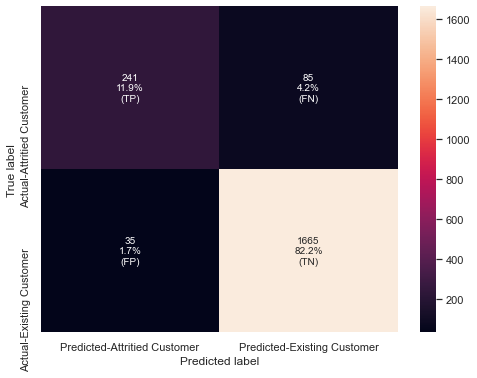

In [70]:
# creating confusion matrix
make_confusion_matrix(bc,X_val,y_val)

- The Bagging Classifier is slightly overfitting
- Metrics are higher in training set than validation set
- Recall is 0.74 on validation set
- The model can be improved reducing overfitting

### 7.4 Random Forest model

In [71]:
# create Random forest with class weights
rf = RandomForestClassifier(class_weight={0:0.16,1:0.84}, random_state=1)
rf.fit(X_train,y_train)

RandomForestClassifier(class_weight={0: 0.16, 1: 0.84}, random_state=1)

**Model performance by using KFold and cross_val_score**

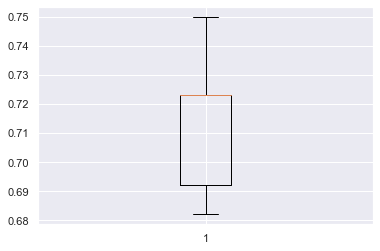

In [72]:
scoring = "recall"
# Setting number of splits equal to 5
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1) 
cv_result_bfr = cross_val_score(estimator=rf, X=X_train, y=y_train, scoring=scoring, cv=kfold)
# Plot boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

- Performance on training set varies between 0.68 to 0.75 recall.

**Performance on validation data**

In [73]:
# checking model performances for this model in train and validation sets
scores_rf = metrics_score(rf,X_train,X_val,y_train,y_val,model_name='Random Forest')
scores_rf

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Random Forest,1.0,0.950148,1.0,0.751534,1.0,0.924528,1.0,0.829103


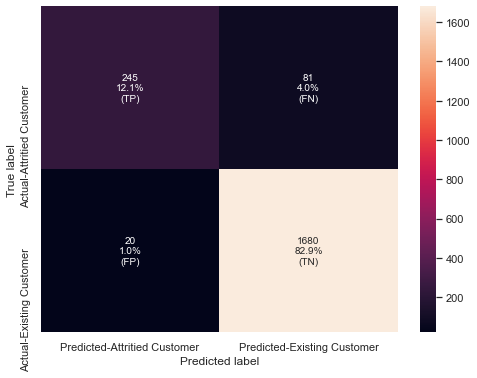

In [74]:
# creating confusion matrix
make_confusion_matrix(rf,X_val,y_val)

- Random Forest is overfitting
- All metrics are 1 in the training set but lower in the validation set
- The model can be improved reducing the overfitting

### 7.5 Gradient Boosting classifier model

In [75]:
# create gradient boosting model
gb = GradientBoostingClassifier(random_state=1)
gb.fit(X_train,y_train)

GradientBoostingClassifier(random_state=1)

**Model performance by using KFold and cross_val_score**

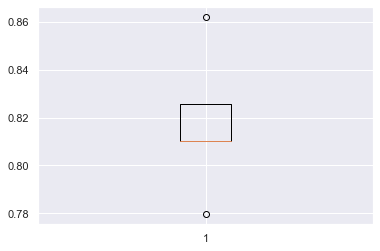

In [76]:
scoring = "recall"
# Setting number of splits equal to 5
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1) 
cv_result_bfr = cross_val_score(estimator=gb, X=X_train, y=y_train, scoring=scoring, cv=kfold)
# Plot boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

- Performance on training set varies between 0.78 to 0.86 recall.

**Performance on validation data**

In [77]:
# checking model performances for this model in train and validation sets
scores_gb = metrics_score(gb,X_train,X_val,y_train,y_val,model_name='Gradient Boosting')
scores_gb

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Gradient Boosting,0.973169,0.967917,0.877049,0.858896,0.952169,0.936455,0.913067,0.896


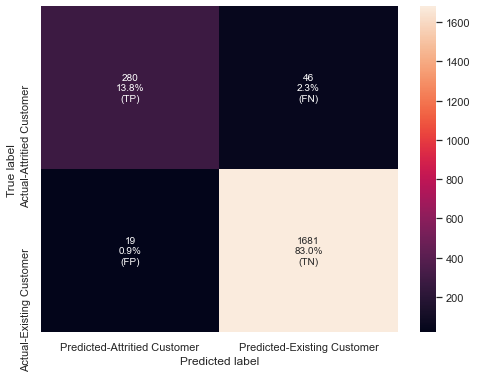

In [78]:
# creating confusion matrix
make_confusion_matrix(gb,X_val,y_val)

- Logistic Regression has given a generalized performance on training and validation sets.
- The model is not overfitting
- All scores are high in both training and validation sets

### 7.6 XGBoost classifier model

In [79]:
# create XGBoost model
xg = XGBClassifier(random_state=1, eval_metric='logloss', use_label_encoder=False)
xg.fit(X_train,y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              use_label_encoder=False, validate_parameters=1, verbosity=None)

**Model performance by using KFold and cross_val_score**

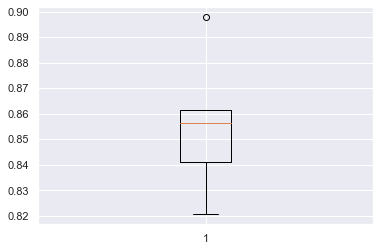

In [80]:
scoring = "recall"
# Setting number of splits equal to 5
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1) 
cv_result_bfr = cross_val_score(estimator=xg, X=X_train, y=y_train, scoring=scoring, cv=kfold)
# Plot boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

- Performance on training set varies between 0.82 to 0.90 recall.

**Performance on validation data**

In [81]:
# checking model performances for this model in train and validation sets
scores_xg = metrics_score(xg,X_train,X_val,y_train,y_val,model_name='XGBoost')
scores_xg

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,XGBoost,1.0,0.970879,1.0,0.886503,1.0,0.92926,1.0,0.907378


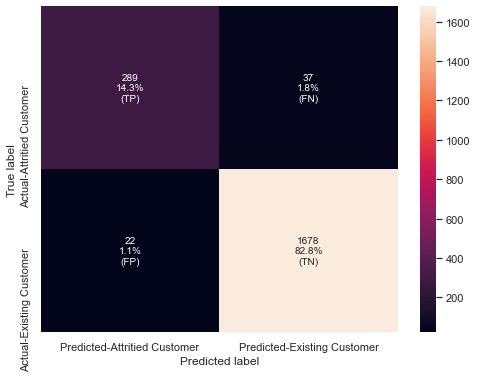

In [82]:
# creating confusion matrix
make_confusion_matrix(xg,X_val,y_val)

- XGboost classifier is overfitting
- All metrics are 1 in the training set but lower in the validation set
- The model can be improved reducing the overfitting

### 7.7 Model Performance Summary
Now, we are going to compare all models using the Recall score in validation sets

In [83]:
# Create dataframe with all scores
scores = pd.concat(
         [scores_lr, 
          scores_dt, 
          scores_bc, 
          scores_rf, 
          scores_gb, 
          scores_xg],
        axis=0,
        ignore_index=True)
scores.sort_values(by=['Recall on validation set'], ascending=False)

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
5,XGBoost,1.000000,0.970879,1.000000,0.886503,1.000000,0.929260,1.000000,0.907378
4,Gradient Boosting,0.973169,0.967917,0.877049,0.858896,0.952169,0.936455,0.913067,0.896000
1,Decision Tree,1.000000,0.941264,1.000000,0.819018,1.000000,0.816514,1.000000,0.817764
3,Random Forest,1.000000,0.950148,1.000000,0.751534,1.000000,0.924528,1.000000,0.829103
2,Bagging Classifier,0.996543,0.940770,0.979508,0.739264,0.998955,0.873188,0.989136,0.800664
0,Logistic Regression,0.876214,0.884995,0.472336,0.527607,0.660458,0.685259,0.550777,0.596187


- XGBoost, Decision Tree and Random Forest present overfitting issues
- We are going to select and tune XGBoost, Gradient Boosting and Decision Tree because they have the highest Recall scores on validation sets

## 8 Model tuning using Random search
We are going to use Recall as metric performance with the goal of reduce False Negatives

### 8.1 Tuned Decision Tree

In [84]:
# dictionary with parameters
param_grid = {'criterion': ['gini', 'entropy'],
              'max_depth': np.arange(1,7,1),
              'max_features': ['sqrt', 'log2'],
              'splitter': ['best', 'random'],
              'min_impurity_decrease': [0.000001, 0.00001, 0.0001],
              }

# Run random search
random_search_obj = RandomizedSearchCV(estimator=dt, param_distributions=param_grid, n_iter=50, scoring='recall',
                              cv=5, random_state=1, n_jobs = -1, verbose=2)
random_search_obj.fit(X_train, y_train)

# get the best combination of parameters
dt_tuned = random_search_obj.best_estimator_

# Fit the best algorithm to the data.
dt_tuned.fit(X_train, y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


DecisionTreeClassifier(class_weight={0: 0.16, 1: 0.84}, criterion='entropy',
                       max_depth=2, max_features='log2',
                       min_impurity_decrease=1e-06, random_state=1,
                       splitter='random')

**Performance on validation data**

In [85]:
# checking model performances for this model for training and validation sets
scores_dt_tuned = metrics_score(dt_tuned,X_train,X_val,y_train,y_val,model_name='Tuned Decision Tree')
scores_dt_tuned

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Tuned Decision Tree,0.177119,0.175222,1.0,0.993865,0.163347,0.162569,0.280823,0.279431


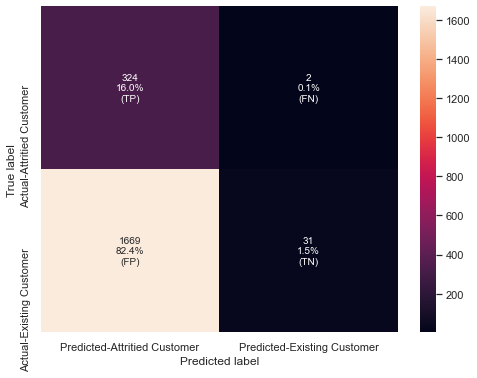

In [86]:
# creating confusion matrix
make_confusion_matrix(dt_tuned,X_val,y_val)

- Although, Recall improves considerably, Precision and Accuracy are very low
- This Tuned Decision Tree model have only 0.1% of False Negatives. However, it is having 82.4% of False Positives
- This model is not performing well because it is forecasting that 98.4% of the customers are Attritied Customers

### 8.2 Tuned Gradient Boosting classifier

In [87]:
# dictionary with parameters
param_grid = {'learning_rate': np.arange(0.1,2,0.1),
              'n_estimators': np.arange(10,210,10),
              'subsample': np.arange(0.1,1,0.1),
              'max_depth': np.arange(1,7,1),
              'max_features': np.arange(0.1,1,0.1),
              }

# Run random search
random_search_obj = RandomizedSearchCV(estimator=gb, param_distributions=param_grid, n_iter=50, scoring='recall',
                              cv=5, random_state=1, n_jobs = -1, verbose=2)
random_search_obj.fit(X_train, y_train)

# get the best combination of parameters
gb_tuned = random_search_obj.best_estimator_

# Fit the best algorithm to the data.
gb_tuned.fit(X_train, y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


GradientBoostingClassifier(learning_rate=1.1, max_depth=2, max_features=0.6,
                           n_estimators=70, random_state=1, subsample=0.9)

**Performance on validation data**

In [88]:
# checking model performances for this model for training and validation sets
scores_gb_tuned = metrics_score(gb_tuned,X_train,X_val,y_train,y_val,model_name='Tuned Gradient Boosting')
scores_gb_tuned

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Tuned Gradient Boosting,0.983045,0.954097,0.936475,0.834356,0.957068,0.874598,0.94666,0.854003


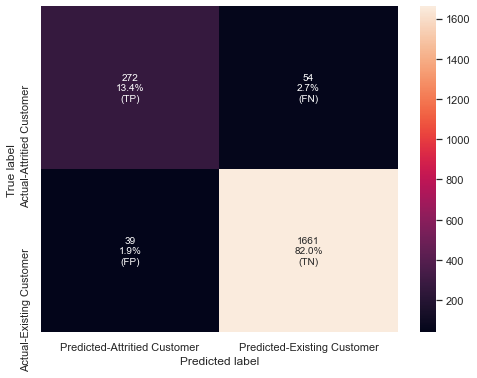

In [89]:
# creating confusion matrix
make_confusion_matrix(gb_tuned,X_val,y_val)

- This Tuned Gradient Boosting have slightly overfitting. Scores are higher in training set than validation set

### 8.3 Tuned XGBoost classifier

In [90]:
# dictionary with parameters
param_grid = {
    'n_estimators': np.arange(10,200,10),
    'scale_pos_weight': np.arange(0,5,1),
    'subsample': np.arange(0.1,1,0.1),
    'learning_rate': np.arange(0.1,2,0.1),
    'gamma': np.arange(0.1,3,0.1),
    'colsample_bytree': np.arange(0.1,1,0.1),
    'colsample_bylevel': np.arange(0.1,1,0.1),
}

# Run random search
random_search_obj = RandomizedSearchCV(estimator=xg, param_distributions=param_grid, n_iter=50, scoring='recall',
                              cv=5, random_state=1, n_jobs = -1, verbose=2)
random_search_obj.fit(X_train, y_train)

# get the best combination of parameters
xg_tuned = random_search_obj.best_estimator_

# Fit the best algorithm to the data.
xg_tuned.fit(X_train, y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=0.5,
              colsample_bynode=1, colsample_bytree=0.5, eval_metric='logloss',
              gamma=2.7, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.2, max_delta_step=0,
              max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=40, n_jobs=8,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=4, subsample=0.4, tree_method='exact',
              use_label_encoder=False, validate_parameters=1, verbosity=None)

**Performance on validation data**

In [91]:
# checking model performances for this model for training and validation sets
scores_xg_tuned = metrics_score(xg_tuned,X_train,X_val,y_train,y_val,model_name='Tuned XGBoost')
scores_xg_tuned

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Tuned XGBoost,0.977613,0.965943,0.983607,0.93865,0.888889,0.861972,0.933852,0.898678


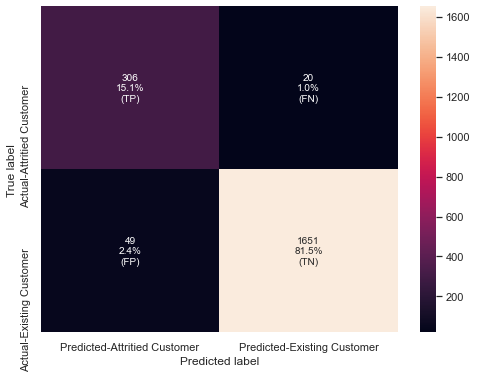

In [92]:
# creating confusion matrix
make_confusion_matrix(xg_tuned,X_val,y_val)

- This Tuned XGBoost classifier presents good performance in both training and validation sets

### 8.4 Model Performance Summary
Now, we are going to compare all models using the Recall score in validation sets

In [93]:
# create dataframe with all scores
tuned_scores = pd.concat(
         [scores_dt_tuned, 
          scores_gb_tuned, 
          scores_xg_tuned],
        axis=0,
        ignore_index=True)
tuned_scores.sort_values(by=['Recall on validation set'], ascending=False)

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Tuned Decision Tree,0.177119,0.175222,1.000000,0.993865,0.163347,0.162569,0.280823,0.279431
2,Tuned XGBoost,0.977613,0.965943,0.983607,0.938650,0.888889,0.861972,0.933852,0.898678
1,Tuned Gradient Boosting,0.983045,0.954097,0.936475,0.834356,0.957068,0.874598,0.946660,0.854003


- Although Tuned Decision Tree presents the highest Recall on validation set, the performance of the model in Accuracy and Precision is very low
- Tuned Gradient Boosting have overfitting problems
- Tuned XGBoost presents good performance in all metrics on both training and validation sets

## 9 Model building - Oversampled data
We are going to fit the 3 tuned models on oversampled data

In [94]:
print("Before UpSampling, counts of label 'Yes': {}".format(sum(y_train == 1)))
print("Before UpSampling, counts of label 'No': {} \n".format(sum(y_train == 0)))

#Oversampling train data using SMOTE
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)

print("After UpSampling, counts of label 'Yes': {}".format(sum(y_train_over == 1)))
print("After UpSampling, counts of label 'No': {} \n".format(sum(y_train_over == 0)))

print("After UpSampling, the shape of train_X: {}".format(X_train_over.shape))
print("After UpSampling, the shape of train_y: {} \n".format(y_train_over.shape))

Before UpSampling, counts of label 'Yes': 976
Before UpSampling, counts of label 'No': 5099 

After UpSampling, counts of label 'Yes': 5099
After UpSampling, counts of label 'No': 5099 

After UpSampling, the shape of train_X: (10198, 28)
After UpSampling, the shape of train_y: (10198,) 



### 9.1 Decision Tree on oversampled data

In [95]:
# create an object of the tuned decision tree model
dt_tuned_over = DecisionTreeClassifier(criterion="gini", random_state=1)
# Training Tuned Decision Tree model with oversampled training set
dt_tuned_over.fit(X_train_over, y_train_over)

DecisionTreeClassifier(random_state=1)

**Performance on validation data**

In [96]:
# checking model performances for this model in train and validation sets
scores_dt_tuned_over = metrics_score(dt_tuned_over,X_train_over,X_val,y_train_over,y_val,
                                     model_name='Decision Tree Oversampled data')
scores_dt_tuned_over

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Decision Tree Oversampled data,1.0,0.921027,1.0,0.785276,1.0,0.739884,1.0,0.761905


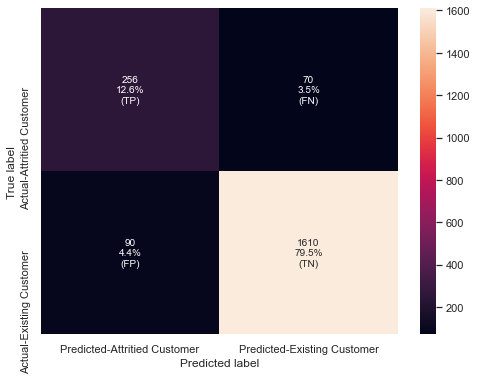

In [97]:
# creating confusion matrix
make_confusion_matrix(dt_tuned_over,X_val,y_val)

- Decision Tree is overfitting
- The model presents low performance on validation set

### 9.2 Gradient Boosting on oversampled data

In [98]:
# create an object of the gradient boosting model
gb_tuned_over = GradientBoostingClassifier(random_state=1)
# Training gradient boosting model with oversampled training set
gb_tuned_over.fit(X_train_over, y_train_over)

GradientBoostingClassifier(random_state=1)

**Performance on validation data**

In [99]:
# checking model performances for this model in train and validation sets
scores_gb_tuned_over = metrics_score(gb_tuned_over,X_train_over,X_val,y_train_over,y_val,
                                     model_name='Gradient Boosting Oversampled data')
scores_gb_tuned_over

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Gradient Boosting Oversampled data,0.981957,0.960513,0.983722,0.883436,0.980262,0.872727,0.981989,0.878049


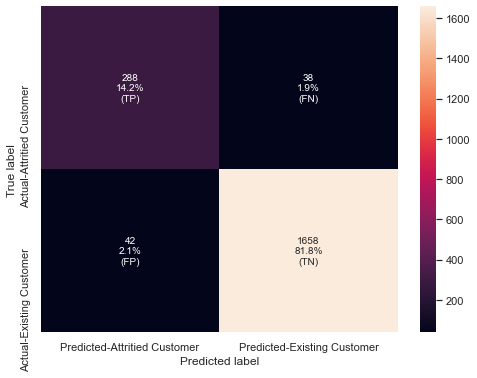

In [100]:
# creating confusion matrix
make_confusion_matrix(gb_tuned_over,X_val,y_val)

- This Tuned Gradient Boosting on oversampled data have slightly overfitting. Scores are higher in training set than validation set

### 9.3 XGBoost classifier on oversampled data

In [101]:
# create an object of the XGBoost model
xg_tuned_over = XGBClassifier(random_state=1, eval_metric='logloss', use_label_encoder=False)
# Training XGBoost model with oversampled training set
xg_tuned_over.fit(X_train_over, y_train_over)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              use_label_encoder=False, validate_parameters=1, verbosity=None)

**Performance on validation data**

In [102]:
# checking model performances for this model in train and validation sets
scores_xg_tuned_over = metrics_score(xg_tuned_over,X_train_over,X_val,y_train_over,y_val,
                                     model_name='XGBoost Oversampled data')
scores_xg_tuned_over

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,XGBoost Oversampled data,1.0,0.965943,1.0,0.883436,1.0,0.902821,1.0,0.893023


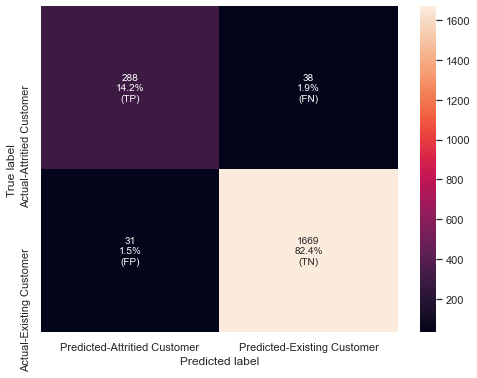

In [103]:
# creating confusion matrix
make_confusion_matrix(xg_tuned_over,X_val,y_val)

- This model presents overfitting 

### 9.4 Model Performance Summary
Now, we are going to compare all models using the Recall score in validation sets

In [104]:
# Create dataframe with all scores
tuned_over_scores = pd.concat(
         [scores_dt_tuned_over, 
          scores_gb_tuned_over, 
          scores_xg_tuned_over],
        axis=0,
        ignore_index=True)
tuned_over_scores.sort_values(by=['Recall on validation set'], ascending=False)

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
1,Gradient Boosting Oversampled data,0.981957,0.960513,0.983722,0.883436,0.980262,0.872727,0.981989,0.878049
2,XGBoost Oversampled data,1.000000,0.965943,1.000000,0.883436,1.000000,0.902821,1.000000,0.893023
0,Decision Tree Oversampled data,1.000000,0.921027,1.000000,0.785276,1.000000,0.739884,1.000000,0.761905


- All models have overfitting problems
- XGBoost and Gradient Boosting have the same Recall score on validation set, but XGBoost presents higher Precision score

## 10 Model building - Undersampled data
We are going to fit the 3 tuned models on undersampled data

In [105]:
# Undersampling train data using Random Under Sampler
rus = RandomUnderSampler(random_state=1)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

print("Before Under Sampling, counts of label 'Yes': {}".format(sum(y_train == 1)))
print("Before Under Sampling, counts of label 'No': {} \n".format(sum(y_train == 0)))

print("After Under Sampling, counts of label 'Yes': {}".format(sum(y_train_un == 1)))
print("After Under Sampling, counts of label 'No': {} \n".format(sum(y_train_un == 0)))

print("After Under Sampling, the shape of train_X: {}".format(X_train_un.shape))
print("After Under Sampling, the shape of train_y: {} \n".format(y_train_un.shape))

Before Under Sampling, counts of label 'Yes': 976
Before Under Sampling, counts of label 'No': 5099 

After Under Sampling, counts of label 'Yes': 976
After Under Sampling, counts of label 'No': 976 

After Under Sampling, the shape of train_X: (1952, 28)
After Under Sampling, the shape of train_y: (1952,) 



### 10.1 Decision Tree on undersampled data

In [106]:
# create an object of the tuned decision tree model
dt_tuned_under = DecisionTreeClassifier(criterion="gini", random_state=1)
# Training Tuned Decision Tree model with undersampled training set
dt_tuned_under.fit(X_train_un, y_train_un)

DecisionTreeClassifier(random_state=1)

**Performance on validation data**

In [107]:
# checking model performances for this model in train and validation sets
scores_dt_tuned_under = metrics_score(dt_tuned_under,X_train_un,X_val,y_train_un,y_val,
                                     model_name='Decision Tree Undersampled data')
scores_dt_tuned_under

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Decision Tree Undersampled data,1.0,0.892399,1.0,0.898773,1.0,0.612971,1.0,0.728856


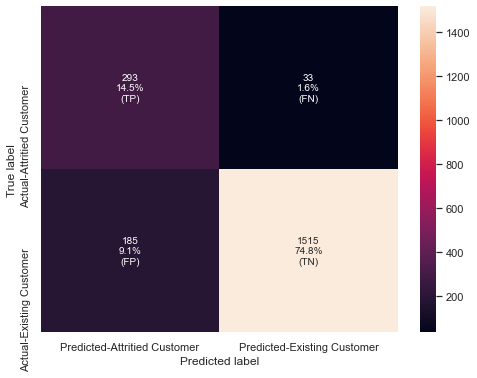

In [108]:
# creating confusion matrix
make_confusion_matrix(dt_tuned_under,X_val,y_val)

- Decision Tree is overfitting
- The model presents low performance on validation set

### 10.2 Gradient Boosting on undersampled data

In [109]:
# create an object of the gradient boosting model
gb_tuned_under = GradientBoostingClassifier(random_state=1)
# Training  Gradient Boosting Tree model with undersampled training set
gb_tuned_under.fit(X_train_un, y_train_un)

GradientBoostingClassifier(random_state=1)

**Performance on validation data**

In [110]:
# checking model performances for this model in train and validation sets
scores_gb_tuned_under = metrics_score(gb_tuned_under,X_train_un,X_val,y_train_un,y_val,
                                     model_name='Gradient Boosting Undersampled data')
scores_gb_tuned_under

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,Gradient Boosting Undersampled data,0.974898,0.937808,0.979508,0.966258,0.970558,0.732558,0.975013,0.833333


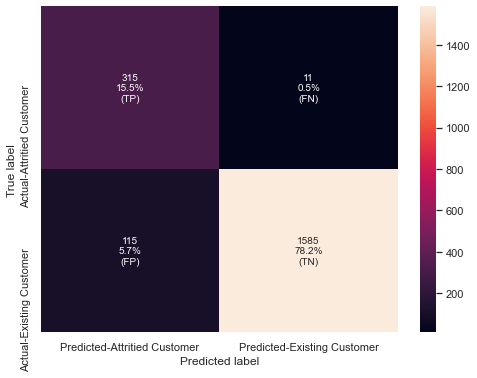

In [111]:
# creating confusion matrix
make_confusion_matrix(gb_tuned_under,X_val,y_val)

- This model presents good performance on Recall score on validation set

### 10.3 XGBoost classifier on undersampled data

In [112]:
# create an object of the XGBoost model
xg_tuned_under = XGBClassifier(random_state=1, eval_metric='logloss', use_label_encoder=False)
# Training XGBoost model with undersampled training set
xg_tuned_under.fit(X_train_un, y_train_un)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              use_label_encoder=False, validate_parameters=1, verbosity=None)

**Performance on validation data**

In [113]:
# checking model performances for this model in train and validation sets
scores_xg_tuned_under = metrics_score(xg_tuned_under,X_train_un,X_val,y_train_un,y_val,
                                     model_name='XGBoost Undersampled data')
scores_xg_tuned_under

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
0,XGBoost Undersampled data,1.0,0.940276,1.0,0.96319,1.0,0.742317,1.0,0.838451


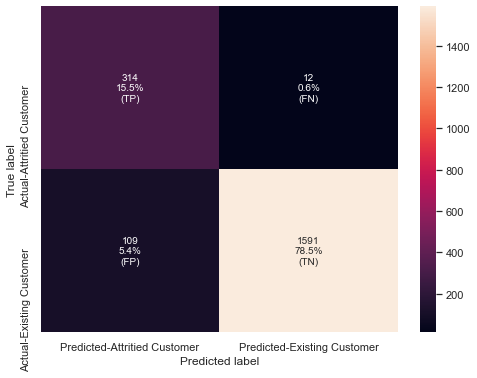

In [114]:
# creating confusion matrix
make_confusion_matrix(xg_tuned_under,X_val,y_val)

- This model presents good performance on Recall score on validation set. However, Precision score drops to 0.74

### 10.4 Model Performance Summary
Now, we are going to compare all models using the Recall score in validation sets

In [115]:
# Create dataframe with all scores
tuned_under_scores = pd.concat(
         [scores_dt_tuned_under, 
          scores_gb_tuned_under, 
          scores_xg_tuned_under],
        axis=0,
        ignore_index=True)
tuned_under_scores.sort_values(by=['Recall on validation set'], ascending=False)

,Model,Accuracy on training set,Accuracy on validation set,Recall on training set,Recall on validation set,Precision on training set,Precision on validation set,F1 on training set,F1 on validation set
1,Gradient Boosting Undersampled data,0.974898,0.937808,0.979508,0.966258,0.970558,0.732558,0.975013,0.833333
2,XGBoost Undersampled data,1.000000,0.940276,1.000000,0.963190,1.000000,0.742317,1.000000,0.838451
0,Decision Tree Undersampled data,1.000000,0.892399,1.000000,0.898773,1.000000,0.612971,1.000000,0.728856


- Gradient Boosting presents good performance in both training and validation sets. Recall score is 0.96 on validation set
- XGBoost and Decision Tree models have overfitting problems. Scores are 1 in Training sets but lower values in validation sets

## 11 Model performances on test set
### 11.1 Model performance summary
Now, we are going to compare all models on test set

In [116]:
# Function to calculate different metric scores of the classification model
def metrics_score_test(model,test,test_y,threshold=0.5,model_name=''):
    '''
    Inputs:
        model: classifier to predict values of X
        test: Independent features in test sets
        test_y: Dependent variable in test sets
        threshold: thresold for classifiying the observation as 1
        model_name: Name of the model
    '''
    
    # Make the prediction of the model in train and test sets
    pred_test = (model.predict_proba(test)[:,1]>threshold)

    # Calculate scores and save them in a dictionary
    score_dict = {'Model':model_name,
                  'Accuracy on test set': accuracy_score(pred_test,test_y),
                  'Recall on test set': recall_score(test_y,pred_test),
                  'Precision on test set': precision_score(test_y,pred_test),
                  'F1 on test set': f1_score(test_y,pred_test)
                 }
    # Create a dataframe with scores
    scores = pd.DataFrame(score_dict,index=[0])
    # return the df
    return scores

In [117]:
# Create dataframe with scores on Test dataset for all models
all_scores = pd.concat(
    [metrics_score_test(dt_tuned,X_test,y_test,model_name='Tuned Decision Tree'),
     metrics_score_test(gb_tuned,X_test,y_test,model_name='Tuned Gradient Boosting'),
     metrics_score_test(xg_tuned,X_test,y_test,model_name='Tuned XGBoost Classifier'),
     metrics_score_test(dt_tuned_over,X_test,y_test,model_name='Decision Tree Oversampled data'),
     metrics_score_test(gb_tuned_over,X_test,y_test,model_name='Gradient Boosting Oversampled data'),
     metrics_score_test(xg_tuned_over,X_test,y_test,model_name='XGBoost Oversampled data'),
     metrics_score_test(dt_tuned_under,X_test,y_test,model_name='Decision Tree Undersampled data'),
     metrics_score_test(gb_tuned_under,X_test,y_test,model_name='Gradient Boosting Undersampled data'),
     metrics_score_test(xg_tuned_under,X_test,y_test,model_name='XGBoost Undersampled data'),
    ],
    axis=0,
    ignore_index=True)
all_scores.sort_values(by=['Recall on test set'], ascending=False)


,Model,Accuracy on test set,Recall on test set,Precision on test set,F1 on test set
0,Tuned Decision Tree,0.178184,1.000000,0.163317,0.280778
7,Gradient Boosting Undersampled data,0.932873,0.963077,0.716247,0.821522
8,XGBoost Undersampled data,0.940770,0.956923,0.745803,0.838275
2,Tuned XGBoost Classifier,0.964956,0.941538,0.854749,0.896047
5,XGBoost Oversampled data,0.977789,0.938462,0.924242,0.931298
6,Decision Tree Undersampled data,0.892892,0.926154,0.609312,0.735043
4,Gradient Boosting Oversampled data,0.964462,0.913846,0.870968,0.891892
1,Tuned Gradient Boosting,0.960020,0.883077,0.869697,0.876336
3,Decision Tree Oversampled data,0.920039,0.836923,0.713911,0.770538


- Tuned Decision Tree has the highest Recall on test set. However, the performance in Accuracy and Precision is very low
- Although XGBoost Undersampled data does not have the highest Recall, this model has very good performance in all metrics. Recall is 0.96, Precision is 0.94, and Accuracy 0.74

### 11.2 Feature importance of XGBoost Undersampled data model

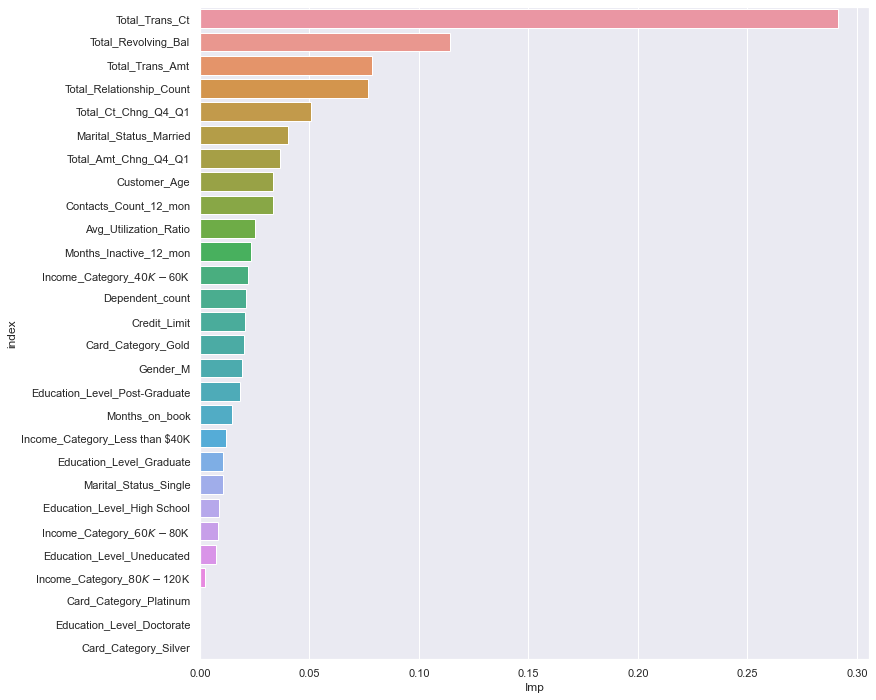

In [118]:
# importance of features in the model
impor_fea = pd.DataFrame(xg_tuned_under.feature_importances_, columns=["Imp"], index=X_train.columns).sort_values(by="Imp", ascending=False)
impor_fea = impor_fea.reset_index()
plt.figure(figsize=(12,12))
sns.barplot(x='Imp', y='index', data=impor_fea);

- Total_Trans_Ct is the most important feature, followed by Total_Revolving_Bal, Total_Trans_Amt and Total_Relationship_Count

## 12 Pipelines for productionizing the model
Now, we have a final model. let's use pipelines to put the model into production. The model chosen is the XGBoost classifier on undersampled data. 

Therefore, the pipeline have 2 steps:
- Undersampling train data
- XGBoost classifier

In [119]:
# Undersampling train data using Random Under Sampler
rus = RandomUnderSampler(random_state=1)

# create an object of the XGBoost model
xg_tuned_under = XGBClassifier(random_state=1, eval_metric='logloss', use_label_encoder=False)

# make pipeline
model = make_pipeline(rus, xg_tuned_under)
model

Pipeline(steps=[('randomundersampler', RandomUnderSampler(random_state=1)),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, eval_metric='logloss',
                               gamma=None, gpu_id=None, importance_type='gain',
                               interaction_constraints=None, learning_rate=None,
                               max_delta_step=None, max_depth=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=None, num_parallel_tree=None,
                               random_state=1, reg_alpha=None, reg_lambda=None,
                               scale_pos_weight=None, subsample=None,
                               tree_method=None, use_label_encoder=False,
         

Now, create independent and dependent variables

In [120]:
# create independent variables
X = data1.drop(['Attrition_Flag'], axis=1)
# create dependent variable
y = data1['Attrition_Flag'].apply(lambda x: 1 if x == 'Attrited Customer' else 0)

In [121]:
# Splitting data into training, validation and test set:
# first we split data into 2 parts, say temporary and test
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.3, random_state=1, stratify=y)
# hot encoding for categorical variables
X_temp = pd.get_dummies(X_temp, drop_first=True)
X_test = pd.get_dummies(X_test, drop_first=True)
print(X_temp.shape, X_test.shape)

(7088, 18) (3039, 18)


Finally, fit the pipeline mode

In [122]:
# Fit the model on training data
model.fit(X_train, y_train)

Pipeline(steps=[('randomundersampler', RandomUnderSampler(random_state=1)),
                ('xgbclassifier',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, eval_metric='logloss',
                               gamma=0, gpu_id=-1, importance_type='gain',
                               interaction_constraints='',
                               learning_rate=0.300000012, max_delta_step=0,
                               max_depth=6, min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=100,
                               n_jobs=8, num_parallel_tree=1, random_state=1,
                               reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
                               subsample=1, tree_method='exact',
                               use_label_encoder=False, validate_parameters=1,
                

## 13 Actionable Insights & Recommendations
### 13.1 Insights of the model
- We have trained a XGBoost Classifier that performs very well on Training and Test data sets.
- We have productionized the final model using Pipelines
- This model was trained using Undersampling data in order to manage the unbalance between the Existing Customers and the Attritied Customers
- The Scores of this model in the test data set are:
    - Accuracy: 0.940770
    - Recall: 0.956923
    - Precision: 0.745803
- The main features of the model are:
    - Total_Trans_Ct
    - Total_Revolving_Bal
    - Total_Trans_Amt
    - Total_Relationship_Count
    
### 13.2 Recommendations for the bank
- The bank should create campaigns to keep customers with 
    - low number of transactions
    - low transaction amount in the last 12 months
    - low revolving balance 
- Those factors are an indication that the customer could close their credit card
-  The bank should engage to create and provide new products to customers because customers with more products tend to keep their accounts
- Low ratios of the total transaction count, and total transaction amount in 4th quarter and in 1st quarter are also an indication that the customer could close the account. The bank should create campaigns to maintain and increase credit card usage the whole year
